In [1]:
# Cell 1 (revised): Dataset + DataLoader with 224×224 center‑crop

from torch.utils.data import Dataset, DataLoader
import os
from glob import glob
import nibabel as nib
import numpy as np
import torch

class BraTSSliceDataset(Dataset):
    def __init__(self, root_dir, indices, crop_size=224):
        all_cases = sorted(os.listdir(root_dir))
        chosen = [all_cases[i] for i in indices]
        self.data = []
        self.crop = crop_size
        for case in chosen:
            case_path = os.path.join(root_dir, case)
            flair_files = glob(os.path.join(case_path, "*flair.nii*"))
            seg_files   = glob(os.path.join(case_path, "*seg.nii*"))
            if not flair_files or not seg_files:
                print(f"Skipping {case}, missing flair/seg")
                continue
            flair = nib.load(flair_files[0]).get_fdata().astype(np.float32)
            seg   = nib.load(seg_files[0]).get_fdata().astype(np.uint8)
            seg[seg == 4] = 3
            flair = (flair - flair.min()) / (flair.max() - flair.min() + 1e-8)
            H, W, D = flair.shape
            top  = (H - crop_size)//2
            left = (W - crop_size)//2

            for z in range(D):
                img_slice = flair[top:top+crop_size, left:left+crop_size, z]
                lbl_slice = seg[top:top+crop_size,   left:left+crop_size,   z]
                self.data.append((img_slice, lbl_slice))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img, lbl = self.data[idx]
        img = torch.tensor(img[None, ...], dtype=torch.float32)  # [1,224,224]
        lbl = torch.tensor(lbl, dtype=torch.long)                # [224,224]
        return img, lbl

# Instantiation remains the same
root = "/home/hiranmoy/Downloads/Sameer/Brats/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData"
all_cases = sorted(os.listdir(root))
valid = [i for i,case in enumerate(all_cases)
         if glob(os.path.join(root,case,"*flair.nii*")) and glob(os.path.join(root,case,"*seg.nii*"))]

train_indices, test_indices = valid[:7], valid[7:10]
train_set = BraTSSliceDataset(root, train_indices, crop_size=224)
test_set  = BraTSSliceDataset(root, test_indices,  crop_size=224)

train_loader = DataLoader(train_set, batch_size=1, shuffle=True,  num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_set,  batch_size=1, shuffle=False, num_workers=2, pin_memory=True)

print("Train samples:", len(train_set), "Batches:", len(train_loader))
print("Test  samples:", len(test_set),  "Batches:", len(test_loader))


Train samples: 1085 Batches: 1085
Test  samples: 465 Batches: 465


In [2]:
# Cell 2: Define SegNet Architecture
import torch.nn as nn

class SegNet(nn.Module):
    def __init__(self, in_ch=1, out_ch=4):
        super().__init__()
        # Encoder (VGG‑like)
        self.enc1 = nn.Sequential(nn.Conv2d(in_ch, 64, 3, padding=1), nn.ReLU(), nn.Conv2d(64,64,3,padding=1), nn.ReLU())
        self.pool1 = nn.MaxPool2d(2,2, return_indices=True)
        self.enc2 = nn.Sequential(nn.Conv2d(64,128,3,padding=1), nn.ReLU(), nn.Conv2d(128,128,3,padding=1), nn.ReLU())
        self.pool2 = nn.MaxPool2d(2,2, return_indices=True)
        self.enc3 = nn.Sequential(nn.Conv2d(128,256,3,padding=1), nn.ReLU(), nn.Conv2d(256,256,3,padding=1), nn.ReLU(), nn.Conv2d(256,256,3,padding=1), nn.ReLU())
        self.pool3 = nn.MaxPool2d(2,2, return_indices=True)
        self.enc4 = nn.Sequential(nn.Conv2d(256,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU())
        self.pool4 = nn.MaxPool2d(2,2, return_indices=True)
        # Bottleneck
        self.enc5 = nn.Sequential(nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU())
        self.pool5 = nn.MaxPool2d(2,2, return_indices=True)

        # Decoder (unpool + convs)
        self.unpool5 = nn.MaxUnpool2d(2,2)
        self.dec5 = nn.Sequential(nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU())
        self.unpool4 = nn.MaxUnpool2d(2,2)
        self.dec4 = nn.Sequential(nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,512,3,padding=1), nn.ReLU(), nn.Conv2d(512,256,3,padding=1), nn.ReLU())
        self.unpool3 = nn.MaxUnpool2d(2,2)
        self.dec3 = nn.Sequential(nn.Conv2d(256,256,3,padding=1), nn.ReLU(), nn.Conv2d(256,256,3,padding=1), nn.ReLU(), nn.Conv2d(256,128,3,padding=1), nn.ReLU())
        self.unpool2 = nn.MaxUnpool2d(2,2)
        self.dec2 = nn.Sequential(nn.Conv2d(128,128,3,padding=1), nn.ReLU(), nn.Conv2d(128,64,3,padding=1), nn.ReLU())
        self.unpool1 = nn.MaxUnpool2d(2,2)
        self.dec1 = nn.Sequential(nn.Conv2d(64,64,3,padding=1), nn.ReLU())

        self.out_conv = nn.Conv2d(64, out_ch, kernel_size=1)

    def forward(self, x):
        # encode
        x, idx1 = self.pool1(self.enc1(x))
        x, idx2 = self.pool2(self.enc2(x))
        x, idx3 = self.pool3(self.enc3(x))
        x, idx4 = self.pool4(self.enc4(x))
        x, idx5 = self.pool5(self.enc5(x))
        # decode
        x = self.unpool5(x, idx5)
        x = self.dec5(x)
        x = self.unpool4(x, idx4)
        x = self.dec4(x)
        x = self.unpool3(x, idx3)
        x = self.dec3(x)
        x = self.unpool2(x, idx2)
        x = self.dec2(x)
        x = self.unpool1(x, idx1)
        x = self.dec1(x)
        return self.out_conv(x)

model = SegNet().cuda()


In [3]:
# Cell 3: Train SegNet
import torch.optim as optim
import torch.nn as nn

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)
num_epochs = 5

for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for imgs, lbls in train_loader:
        imgs, lbls = imgs.cuda(), lbls.cuda()
        preds = model(imgs)
        loss = criterion(preds, lbls)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Epoch {epoch+1}/{num_epochs}  Loss: {total_loss/len(train_loader):.4f}")



Epoch 1/5  Loss: 0.1078
Epoch 2/5  Loss: 0.0307
Epoch 3/5  Loss: 0.0286
Epoch 4/5  Loss: 0.0224
Epoch 5/5  Loss: 0.0271


In [4]:
# Cell 4: PCA on SegNet Bottleneck Features

from sklearn.decomposition import PCA
import numpy as np

model.eval()
all_pca_maps = []

for img, _ in train_loader:
    img = img.cuda()
    with torch.no_grad():
        # forward up to enc5 output (before pool5)
        x, i1 = model.pool1(model.enc1(img))
        x, i2 = model.pool2(model.enc2(x))
        x, i3 = model.pool3(model.enc3(x))
        x, i4 = model.pool4(model.enc4(x))
        feat = model.enc5(x)  # shape [1,512,7,7]
    feat_np = feat.cpu().numpy().squeeze(0)  # [512,7,7]
    C, H, W = feat_np.shape
    X = feat_np.reshape(C, -1).T            # [H*W, C]
    pca = PCA(n_components=3).fit(X)
    maps = pca.transform(X).T.reshape(3, H, W)
    all_pca_maps.append((feat_np, maps))


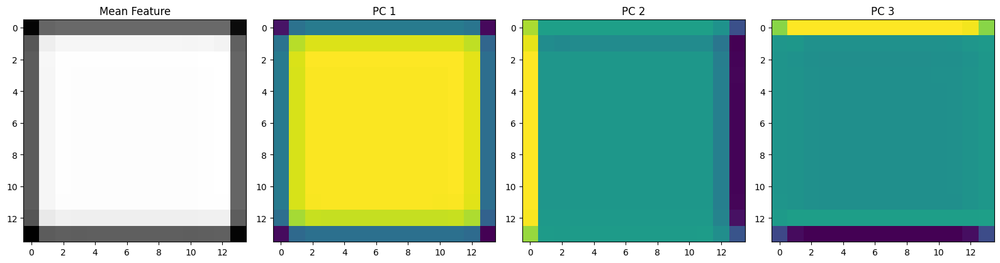

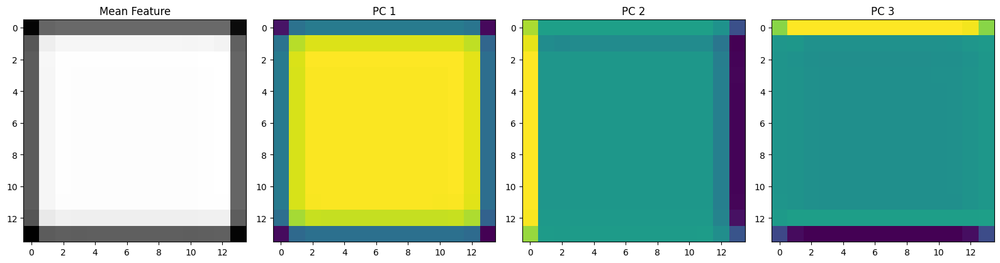

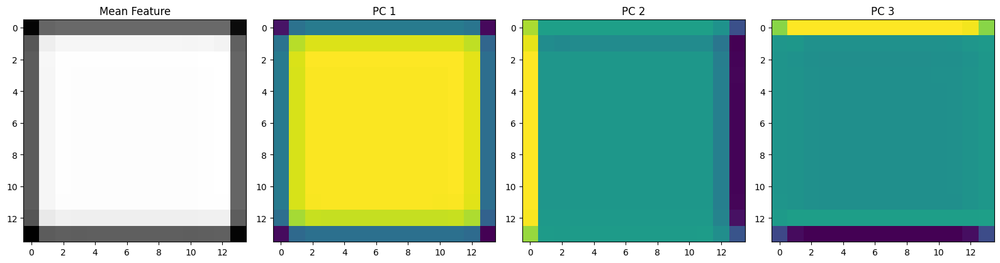

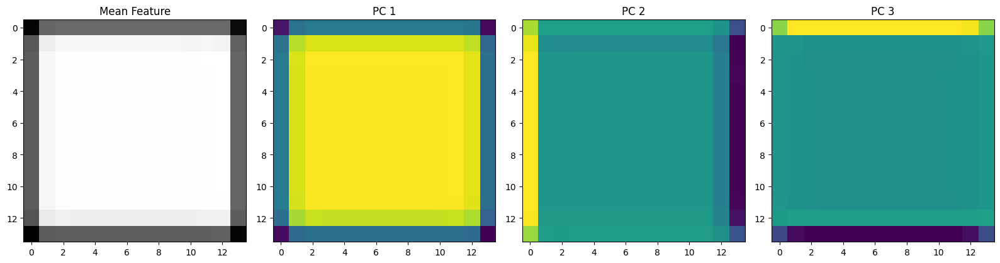

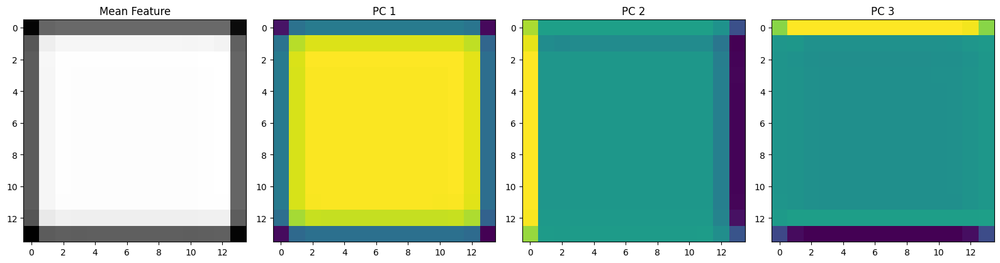

...

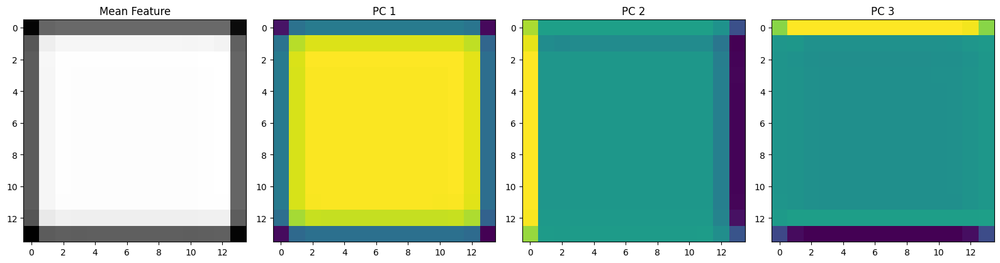

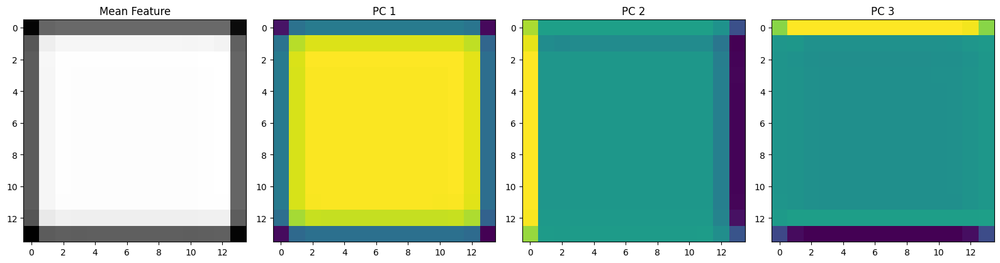

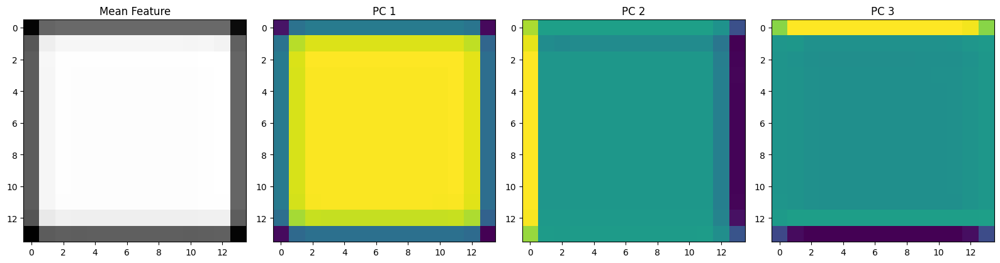

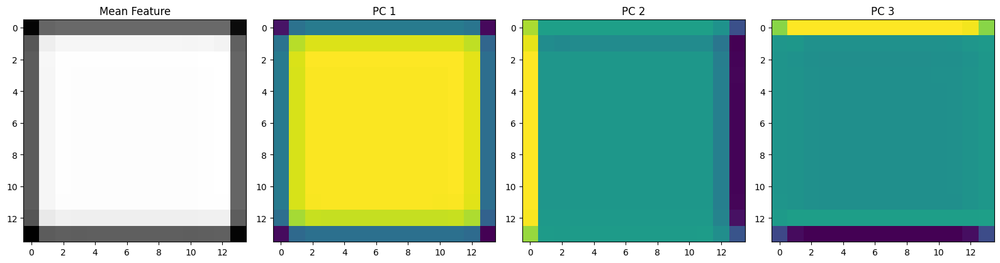

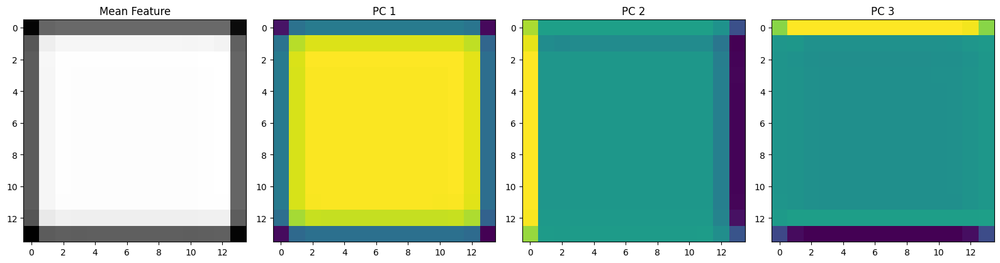

In [5]:
# Cell 5: Visualize PCA Maps

import matplotlib.pyplot as plt

for i, (feat, maps) in enumerate(all_pca_maps):
    fig, axs = plt.subplots(1, 4, figsize=(16,4))
    axs[0].imshow(feat.mean(0), cmap='gray'); axs[0].set_title('Mean Feature')
    for j in range(3):
        axs[j+1].imshow(maps[j], cmap='viridis')
        axs[j+1].set_title(f'PC {j+1}')
    plt.tight_layout(); plt.show()


In [6]:
# Cell 6: Variance, Intrinsic Dim, Entropy Metrics

import numpy as np
from scipy.stats import entropy

metrics = []
for feat_np, maps in all_pca_maps:
    C, H, W = feat_np.shape
    X = feat_np.reshape(C, -1).T
    pca_full = PCA().fit(X)
    cumvar = np.cumsum(pca_full.explained_variance_ratio_)
    intrinsic_dim_90 = np.searchsorted(cumvar, 0.90) + 1

    pca3 = PCA(n_components=3).fit(X)
    vr = pca3.explained_variance_ratio_

    ent = []
    for m in maps:
        flat = m.flatten()
        flat = (flat - flat.min()) / (flat.max() - flat.min() + 1e-8)
        hist, _ = np.histogram(flat, bins=50, range=(0,1), density=True)
        ent.append(entropy(hist + 1e-8))
    metrics.append({
        'var_pc1': vr[0], 'var_pc2': vr[1], 'var_pc3': vr[2],
        'sum_var3': vr.sum(), 'int_dim90': intrinsic_dim_90,
        'ent_pc1': ent[0], 'ent_pc2': ent[1], 'ent_pc3': ent[2]
    })

import pandas as pd; df = pd.DataFrame(metrics)
df.head()


,var_pc1,var_pc2,var_pc3,sum_var3,int_dim90,ent_pc1,ent_pc2,ent_pc3
0,0.851446,0.062260,0.044808,0.958515,2,1.69695,1.532007,1.620506
1,0.851447,0.062260,0.044808,0.958515,2,1.69695,1.532007,1.620506
2,0.851421,0.062271,0.044816,0.958508,2,1.69695,1.532007,1.620506
3,0.851461,0.062256,0.044802,0.958519,2,1.69695,1.532007,1.620506
4,0.851430,0.062267,0.044813,0.958510,2,1.69695,1.532007,1.620506


In [8]:
# Cell 7: SSIM / MS-SSIM / LPIPS Diversity (Batched on GPU)

import torch
import torch.nn.functional as F
from pytorch_msssim import ssim, ms_ssim
import lpips
import numpy as np

# --- Prepare tensors ---
mean_maps = [feat.mean(0) for feat, _ in all_pca_maps]  # each [7,7]
t_all = torch.stack([torch.from_numpy(m).unsqueeze(0) for m in mean_maps], dim=0).cuda()  # [N,1,7,7]

lpips_fn = lpips.LPIPS(net='alex').cuda()

pairs = [(i, j) for i in range(len(t_all)) for j in range(i + 1, len(t_all))]
BATCH, UPS = 64, 192  # upsample to 192 (>160) for MS-SSIM

div_ssim, div_mss, div_lp = [], [], []

with torch.no_grad():
    for start in range(0, len(pairs), BATCH):
        batch = pairs[start:start + BATCH]
        iA, iB = zip(*batch)
        A, B = t_all[list(iA)], t_all[list(iB)]

        # --- SSIM ---
        s = ssim(A, B, data_range=1.0)
        div_ssim.append((1 - s).cpu())

        # --- Upsample for MS-SSIM & LPIPS ---
        A_up = F.interpolate(A, size=(UPS, UPS), mode='bilinear', align_corners=False)
        B_up = F.interpolate(B, size=(UPS, UPS), mode='bilinear', align_corners=False)

        # --- MS-SSIM ---
        m = ms_ssim(A_up, B_up, data_range=1.0)
        div_mss.append((1 - m).cpu())

        # --- LPIPS (requires 3-channel, [-1,1]) ---
        A_lp = A_up.repeat(1, 3, 1, 1) * 2 - 1
        B_lp = B_up.repeat(1, 3, 1, 1) * 2 - 1
        lp = lpips_fn(A_lp, B_lp).flatten().cpu()
        div_lp.append(lp)

div_ssim = torch.cat(div_ssim)
div_mss = torch.cat(div_mss)
div_lp = torch.cat(div_lp)

print(f"SSIM div   : {div_ssim.mean():.4f} ± {div_ssim.std():.4f}")
print(f"MS-SSIM div: {div_mss.mean():.4f} ± {div_mss.std():.4f}")
print(f"LPIPS dist : {div_lp.mean():.4f} ± {div_lp.std():.4f}")


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/hiranmoy/.local/lib/python3.10/site-packages/lpips/weights/v0.1/alex.pth


RuntimeError: zero-dimensional tensor (at position 0) cannot be concatenated

In [ ]:
# Cell 8: Pixel‑Level Clustering + t‑SNE on First Slice

import numpy as np
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

feat_np, _ = all_pca_maps[0]       # [512,7,7]
C, H, W = feat_np.shape
X = feat_np.reshape(C, -1).T       # [49,512]

kmeans = KMeans(n_clusters=6, random_state=0).fit(X)
labels = kmeans.labels_.reshape(H, W)

plt.figure(figsize=(4,4))
plt.imshow(labels, cmap='tab10'); plt.axis('off'); plt.title('Clusters')
plt.show()

idx = np.random.choice(H*W, size=49, replace=False)
Z = TSNE(n_components=2, random_state=0).fit_transform(X[idx])
labs = kmeans.labels_[idx]

plt.figure(figsize=(5,5))
for k in range(6):
    mask = labs==k
    plt.scatter(Z[mask,0], Z[mask,1], s=20, label=f'Cl {k}')
plt.legend(); plt.title('t‑SNE'); plt.show()


In [ ]:
# Cell 9: Summary Explanation

"""
1. Loaded/cropped 224×224 FLAIR slices and masks.
2. Defined SegNet with 5 pooling levels → 512→512 bottleneck at 7×7 resolution.
3. Trained with cross-entropy for segmentation.
4. Extracted the 512-channel bottleneck per slice (7×7 spatial).
5. Ran PCA on those 512-d pixels to get top 3 component maps and visualized them.
6. Computed variance ratios, intrinsic dimension, and map entropies.
7. Measured SSIM, MS-SSIM, and LPIPS diversity across mean-feature maps.
8. Clustered bottleneck pixels (k-means) and visualized clusters and t-SNE.
"""
